<a href="https://youtu.be/qkTkVv7m-2w" target="_parent"><img src="https://upload.wikimedia.org/wikipedia/commons/thumb/0/09/YouTube_full-color_icon_%282017%29.svg/71px-YouTube_full-color_icon_%282017%29.svg.png" alt="Open In Colab"/></a>

# Práctico Content-based (Imágenes)

Profesor: Denis Parra

Ayudantes: Vladimir Araujo, Andrés Carvallo, Manuel Cartagena, Francisca Catán, Andres Villa 

Agradecimientos: Pablo Messina

En este proyecto trabajaremos con un modelo de [recomendación de arte](http://dparra.sitios.ing.uc.cl/pdfs/preprint-ugallery-UMUAI-2018.pdf). El modelo de recomendación de arte es un modelo basado en contenido, donde se utilizan redes neuronales convolucionales para el cálculo de similaridades de ítems. Luego, dependiendo de los productos que el usuario ha consumido, se recomiendan los ítems más similares.

In [15]:
import numpy as np
import json
import requests
import heapq
import math
import matplotlib.pyplot as plt
from sklearn.metrics import pairwise_distances
from sklearn.decomposition import PCA
from PIL import Image
from io import BytesIO
import pickle

Cargamos datos que vienen previamente calculados: 
- labels reales (ground truth)
- transacciones/interacciones de cada usuario 
- diccionarios auxiliares (index2id y id2index)
- embeddings de imágenes calculados con red VGG19 
- embeddings de imágenes calculados con red ResNet50 

In [16]:
!curl -L -o "assets.tar.gz" "https://drive.google.com/uc?export=download&id=1PDvB7at0AmDSXFFcXe9nO6k2QbbJpzqY"
!tar -xvzf assets.tar.gz

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   388    0   388    0     0     27      0 --:--:--  0:00:14 --:--:--    80
100 5290k  100 5290k    0     0   366k      0  0:00:14  0:00:14 --:--:-- 24.2M
assets/
assets/ground_truth.pickle
assets/past_transactions.pickle
assets/index2artworkId.json
assets/vgg19_feature_matrix.npy
assets/artworkImageUrlsCache.json
assets/resnet50_feature_matrix.npy
assets/user_transaction_dict.pickle


# Cargar caracteristicas visuales pre-entrenadas: Redes ResNet50 and VGG19

En esta sección se trabajará con modelos pre-entrenados de redes convolucionales (CNN) que extraen caracteristicas visuales de las imagenes. Usaremos las arquitecturas ResNet50 y VGG19

![Ejemplo de red convolucional](http://dparra.sitios.ing.uc.cl/img/alexnet-ugallery.png)


Para los curiosos se recomienda revisar los siguientes links:

- Artículo: [Understand Deep Residual Networks](https://medium.com/@14prakash/understanding-and-implementing-architectures-of-resnet-and-resnext-for-state-of-the-art-image-cf51669e1624)
- [Keras applications](https://keras.io/applications/)

Para efectos de este trabajo los vectores de características ya fueron entrenados y guardados en archivos numpy. A continuación son cargados en memoria.

In [17]:
resnet50_featmat = np.load('./assets/resnet50_feature_matrix.npy', allow_pickle=True)
vgg19_featmat = np.load('./assets/vgg19_feature_matrix.npy', allow_pickle=True)

### **Pregunta 1** 

Considerando que haremos un recomendador basado en contenidos ¿Por qué el uso de estas redes (CNN) es una buena elección para este tipo de problema?

**Respuesta 1**

Lo que hace un CNN es encontrar diferentes features para algún item. Debido a que el tipo de item que estamos usando son las pinturas, esto hace que usar CNN sea una buena elección. Esto se debe a que podemos ver que algunas pinturas tienen ciertas features y podemos recomendar a base de eso. Por ejemplo, si a alguien le gusta algunas pinturas con personas, entonces se podría recomendar otras pinturas con personas; o si a alguien le gusta pinturas de paisaje entonces se puede recomendar del mismo tipo. Todo esto está basado en el contenido de las pinturas y sus diferentes features que tengan (y que se aprendieron en la red neuronal).

### Pregunta 2

Considerando que para este problema las pinturas son únicas, ¿Sirve utilizar modelos antes vistos de filtrado colaborativo (UserKNN, ItemKNN, etc) ? Justifique con los contenidos vistos del curso esta respuesta. Del mismo modo, ¿sirve utilizar Most Popular? ¿Por qué?


**Respuesta 2**

Filtrado colaborativo existe gracias a poder recomendar items basado en la cantidad de personas que la han gustado (o consumido). Si tenemos items que son únicas, entonces lsa cantidad máxima de personas que pueden consumir/darle rating es 1. FC necesita que suficiente personas le den ratings a un item para que funcione (por ahí viene el problema del Cold Start, pero no es parte de esta pregunta), y por lo tanto, no funcionaría tan bien en este problema. \\

Lo mismo para al Utilizar Most Popular, ya que solo a una persona le podría gustar (o no gustar) un item ya que ellos serían los únicos en tenerlo. \\

Si hay una forma de hacer que estos modelos funcionen, y es que en vez de centrarnos en pinturas, es recomendar a pintores. Un pintor muy popular ha vendido muchas pinturas, y podemos usar Most Popular para recomendarlo a más gente. De mismo modo, podemos ver que si hay gente que ha comprado de pintores iguales a nosotros, podríamos recomendar otros pintores que ellos les han comprado (una forma de kNN).

# Cargar archivos adicionales json

En esta sección se cargan archivos auxiliares que luego serán útiles para el cálculo de las recomendaciones.

In [18]:
print('Loading index2artworkId.json')
with open('./assets/index2artworkId.json') as f:
    index2id = json.load(f)
    id2index = {_id:i for i,_id in enumerate(index2id)}
    
print('Loading past_transactions.pickle')
with open('./assets/past_transactions.pickle', 'rb') as f:
    past_transactions = pickle.load(f)
    
print('Loading ground_truth.pickle')
with open('./assets/ground_truth.pickle', 'rb') as f:
    ground_truth = pickle.load(f)
    
print("-------------")
print("Cantidad de usuarios distintos: ", len(index2id))
print("Cantidad de features en ResNET50: ", resnet50_featmat.shape[1])
print("Cantidad de features en VGG19: ", vgg19_featmat.shape[1])

Loading index2artworkId.json
Loading past_transactions.pickle
Loading ground_truth.pickle
-------------
Cantidad de usuarios distintos:  300
Cantidad de features en ResNET50:  2048
Cantidad de features en VGG19:  4096


# Concatenar  ResNet50 + VGG19, aplicar normalización z-score normalization y finalmente PCA(20)

Una vez calculado (o cargado) los vectores característicos de cada imagen, se deben preprocesar para generar un único vector por cada instancia. Para lograr este objetivo se concatenan los vectores de las redes ResNet50 y VGG19, luego son normalizados restando la media del vector a cada dimensión y luego dividir por su desviación estándar.

$x_i = \frac{x_i - \bar{x}}{\sigma}$

Finalmente los vectores son reducidos a una dimensión de 20 mediante el algoritmo PCA.

In [19]:
def normalize_zscore_inplace(featmat):
    means = featmat.mean(0)
    stds = featmat.std(0)
    for i in range(stds.shape[0]):
        if stds[i] == 0:
            stds[i] = 1
    featmat -= means
    featmat /= stds

In [20]:
n_artworks = len(index2id)
resnet50_dim = resnet50_featmat.shape[1]
vgg19_dim = vgg19_featmat.shape[1]

In [21]:
resnet_vgg_hybrid_featmat = np.empty(shape=(n_artworks, resnet50_dim + vgg19_dim))

for i in range(n_artworks):
    resnet_vgg_hybrid_featmat[i][:resnet50_dim] = resnet50_featmat[i]
    resnet_vgg_hybrid_featmat[i][resnet50_dim:] = vgg19_featmat[i]
    
normalize_zscore_inplace(resnet_vgg_hybrid_featmat)

In [22]:
# Project into a 20 PCA feature space
pca20_resnet_vgg_hybrid_featmat = PCA(n_components=20).fit_transform(resnet_vgg_hybrid_featmat)

print("Cantidad de features despues de PCA: ", pca20_resnet_vgg_hybrid_featmat.shape[1])

Cantidad de features despues de PCA:  20


## **Pregunta 3**

Comente por qué se utiliza PCA para reducir la dimensión de cada vector característico. ¿Qué sucede con la pérdida de información en la reducción de dimensionalidad?

**Respuesta 3**

Se baja de dimensionalidad para poder disminuir el costo computacional que se tiene que hacer. Esto puede hacer que una recomendación se demore 5 veces menos que si no se hubiera bajado la dimensionalidad (esto se vió empíricamente en el práctico anterior, utilizando recomendación basada en contenido para texto). Al bajar la dimensionalidad, se va a perder información (eso es inevitable), pero nos quedamos con información un poco más general. \\

En el práctico anterior, mencioné un ejemplo de este: tenemos puntos en 2 dimensiones y podemos bajar la dimensionalidad de este con una recta. Esta recta va a pasar por los puntos y será un aproximado de lo que tenemos. Por eso al bajar la dimensionalidad nos quedamos con menos información (ya no sabemos exactamente donde estaban los puntos) pero quedamos con información más general (nos quedamos con la recta). Esto puede ser bueno para redes neuronales para contrarrestar el overfitting, ya que estaríamos utilizando información general en vez de información que podría ser ruído.

# Similar image retrieval

En esta sección utilizaremos los vectores cargados para hacer un sistema de recuperación o búsqueda de información, para diferentes métricas de distancia. El siguiente código es una clase utiliza de forma **interna** (no editar) para manejar las imágenes que verán despues.

In [23]:
class _ImageHandler:

    def __init__(self):
        self._IMAGE_URLS = None
        self._IMAGES_CACHE = dict()

    def _load_image_urls(self):
        if self._IMAGE_URLS is None:
            with open('./assets/artworkImageUrlsCache.json') as f:
                self._IMAGE_URLS = json.load(f)
    
    def _download_image(self, _id):
        url = self._IMAGE_URLS[str(_id)]['medium']
        try:
            r = requests.get(url, timeout=4)
        except requests.exceptions.Timeout:
            print('timeout detected for url = ', url)
            return False
        if r.status_code == 200:
            img = Image.open(BytesIO(r.content))
            self._IMAGES_CACHE[_id] = img
            return True
        else:
            print('unexpected r.status_code = %d for url = %s' % (r.status_code, url))
            return False
    
    def download_images(self, ids):
        missing_ids = [_id for _id in ids if _id not in self._IMAGES_CACHE]
        if len(missing_ids) == 0:
            return        
        self._load_image_urls()
        from concurrent.futures import ThreadPoolExecutor
        with ThreadPoolExecutor(max_workers=30) as executor:
            executor.map(self._download_image, missing_ids)
            executor.shutdown(wait=True)    

    def get_image(self, _id):
        try:
            img = self._IMAGES_CACHE[_id]
        except KeyError:
            self._load_image_urls()
            if self._download_image(_id):
                img = self._IMAGES_CACHE[_id]
            else:
                img = None
        return img

ImageHandler = _ImageHandler() # singleton instance

La siguiente función es para imprimir las imágenes en pantalla. **(no editar)**.

In [24]:
def plot_images(ids):    
    plt.close()
    n = len(ids)
    nrows = math.ceil(n/5)
    ncols = min(n, 5)
    plt.figure(1, (20, 5 * nrows))

    ImageHandler.download_images(ids)
    for i, _id in enumerate(ids):
        ax = plt.subplot(nrows, ncols, i+1)
        ax.set_yticks([])
        ax.set_xticks([])
        img = ImageHandler.get_image(_id)
        if img is None:
            ax.set_title('%d) id = %d not found' % (i, _id))
        else:
            ax.set_title('%d) id = %d' % (i, _id))
            ax.imshow(img, interpolation="nearest")
    plt.show()

La siguiente función busca las `topk` imágenes más cercanas según la métrica de distancia indicada. **no editar**.

In [25]:
# Find similar images by image id
def find_similar_images(embedding, query_id=None, metrics=('euclidean',), topk=5):
    assert len(metrics) > 0
    assert topk <= 30 # to avoid requesting too many images
    n = embedding.shape[0]
    if query_id is None:
        query_i = np.random.randint(n)
        query_id = index2id[query_i]
    else:
        query_i = id2index[query_id]
        
    # --- show query image
    plt.title('query_id = %d' % query_id)
    plt.imshow(ImageHandler.get_image(query_id))
    plt.xticks([])
    plt.yticks([])
    plt.show()

    # --- show retrieved images for each metric
    for metric in metrics:
        print('-------- retrieved with metric = %s -----' % metric)
        distances = pairwise_distances(embedding[query_i].reshape(1,-1), embedding, metric=metric)
        heap = []
        for i in range(n):            
            if len(heap) < topk:
                heapq.heappush(heap, (-distances[0][i], i))
            else:
                heapq.heappushpop(heap, (-distances[0][i], i))
        heap.sort(reverse=True)
        rec_ids = [index2id[i] for _,i in heap]
        plot_images(rec_ids)

**Esta forma de ranking funciona bien para datasets pequeños, para cosas de mayor tamaño pruebe con cosas como [Annoy](https://github.com/spotify/annoy)**

## Usando ResNet50

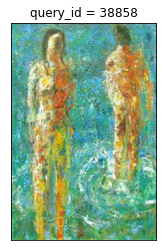

-------- retrieved with metric = cosine -----
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg


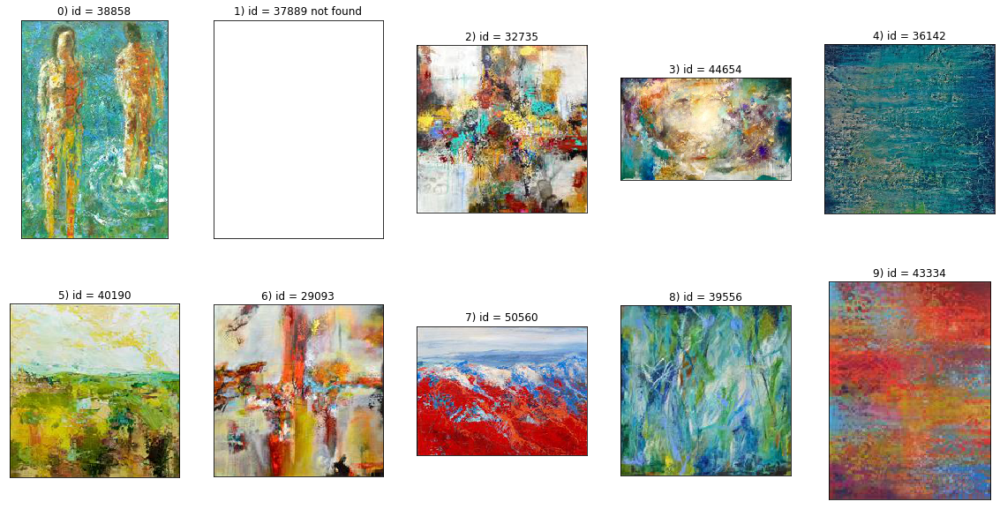

-------- retrieved with metric = euclidean -----
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg


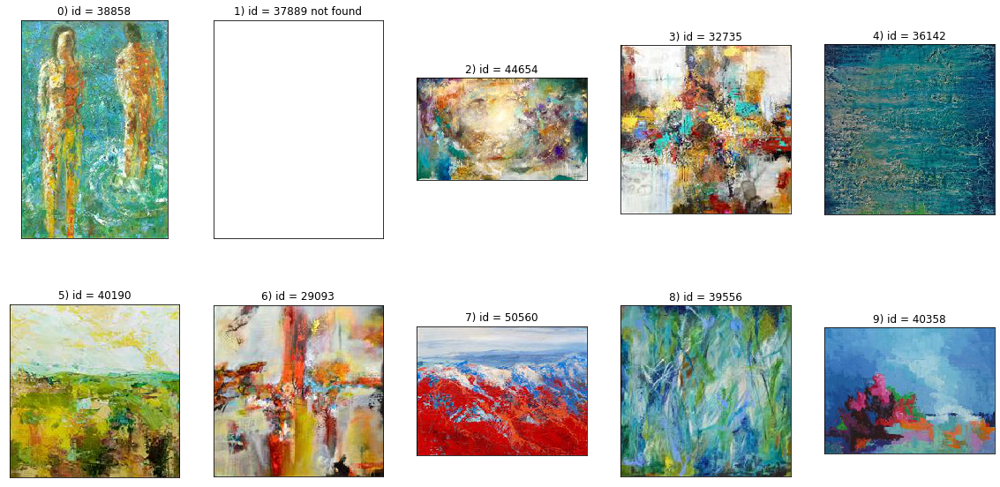

In [26]:
# Retrieve images using ResNet50
find_similar_images(resnet50_featmat, metrics=('cosine','euclidean'), query_id=38858, topk=10)

## Usando VGG19

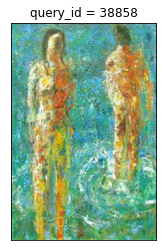

-------- retrieved with metric = cosine -----


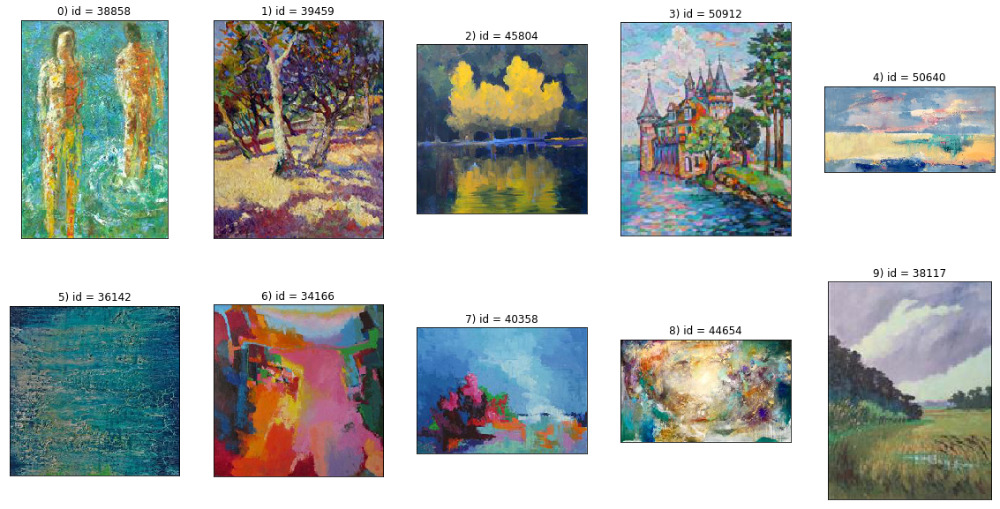

-------- retrieved with metric = euclidean -----


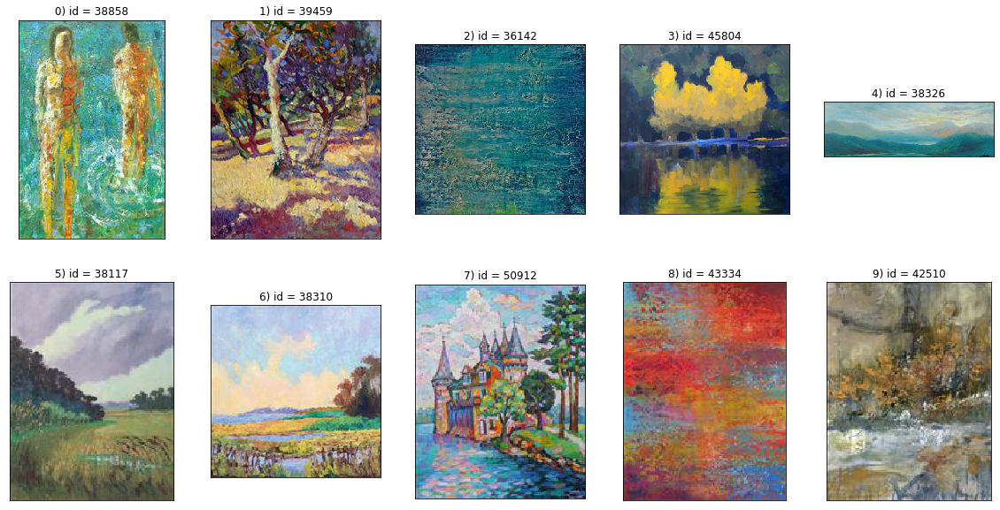

In [27]:
# Retrieve images using VGG19 and cosine similarity
find_similar_images(vgg19_featmat, metrics=('cosine','euclidean'), query_id=38858, topk=10)

## Usando PCA(20) sobre ResNet50+VGG19

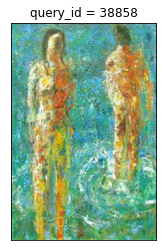

-------- retrieved with metric = cosine -----
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40365/Images/Medium_The_Expressionist.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40365/Images/Medium_The_Expressionist.jpg


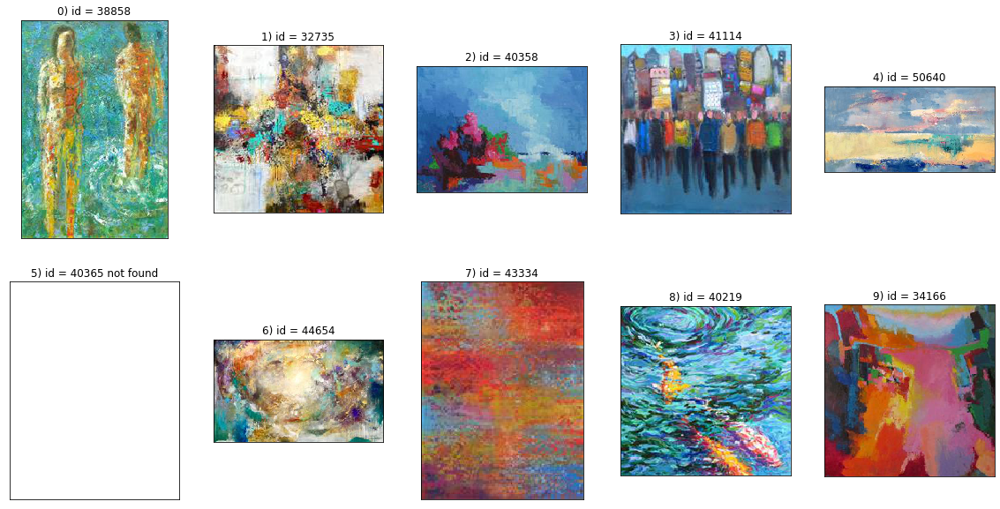

-------- retrieved with metric = euclidean -----


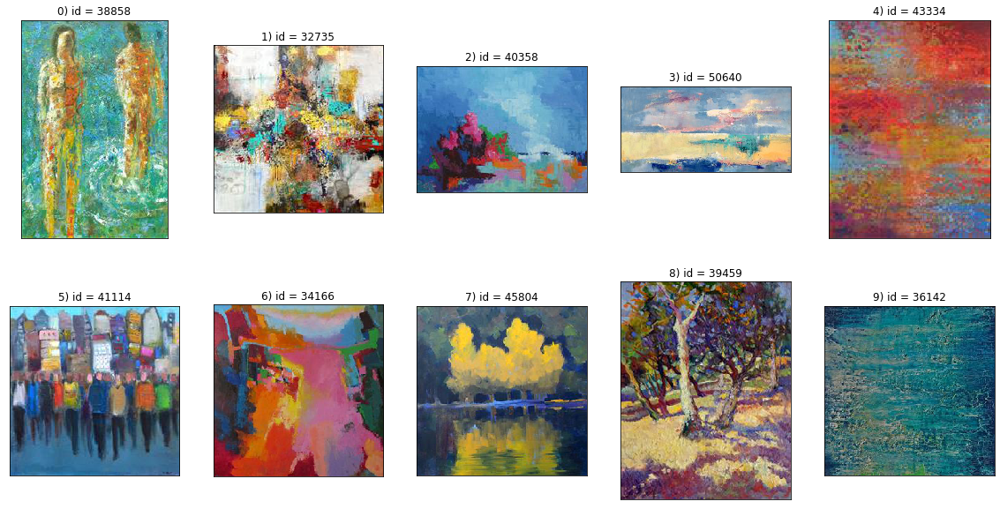

In [28]:
# Retrieve images using PCA features, cosine and euclidean similarity
find_similar_images(pca20_resnet_vgg_hybrid_featmat, metrics=('cosine','euclidean'), query_id=38858, topk=10)

# Recomendaciones

El de recomendación para un usuario del siguiente modo:

1. Para cada transacción del usuario, se calcula la distancia entre la pintura comprada y todas las demás ítems posibles a recomendar. 
2. Se busca aquella transacción que tenga la mínima distancia posible a todos los demás ítems
3. Se recomienda las pinturas utilizando la distancia de la transacción obtenida en el punto 2. Para esto se van entregando las pinturas que tienen menor distancia a esta. A medida que aumenta la recomiendación, la distancia aumenta. 

Para el ordenamiento se utilizó el algoritmo [`heapsort`](https://es.wikipedia.org/wiki/Heapsort).

## Ejemplos de recomendación

In [29]:
def recommend(embedding, user_id=None, topk=10, metric='cosine'):
    if user_id is None:
        user_id = np.random.randint(0, 25)
    assert user_id >= 0
    assert user_id < 25
    
    print("user_id = ", user_id)
    
    #Calculate distance metrics
    trx = past_transactions[user_id]
    n = embedding.shape[0]
    distances = 1e9
    
    # recorremos transacciones pasadas del usuario 
    for t in trx:
        query_i = id2index[t]
        
        # recomendamos items más cercanos a items con los que interactuó el usuario
        distances = np.minimum(distances, pairwise_distances(
                embedding[query_i].reshape(1,-1), embedding, metric=metric).reshape(-1))

    #Rank items de menor a mayor distancia (nos quedamos con los topk)
    trx_set = set(trx)
    heap = []
    for i in range(n):
        if index2id[i] in trx_set:
            continue
        if len(heap) < topk:
            heapq.heappush(heap, (-distances[i], i))
        else:
            heapq.heappushpop(heap, (-distances[i], i))
    heap.sort(reverse=True)
    
    # utilizamos un heap para extraer los items ordenados de menor a mayor distancia 
    recommended_ids = [index2id[i] for _,i in heap]
    
    #Show consumed items
    print('\t\t\t\t============ Consumed items =============\n\n')
    plot_images(trx)

    #Show recommended items
    print('\n\n\n\t\t\t\t============ Recommended items =============\n\n')
    plot_images(recommended_ids)
    return recommended_ids

user_id =  8
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40275/Images/Medium_bakery_at_night_padaria_hopper.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44675/Images/Medium_recliningnude.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40275/Images/Medium_bakery_at_night_padaria_hopper.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44675/Images/Medium_recliningnude.jpg


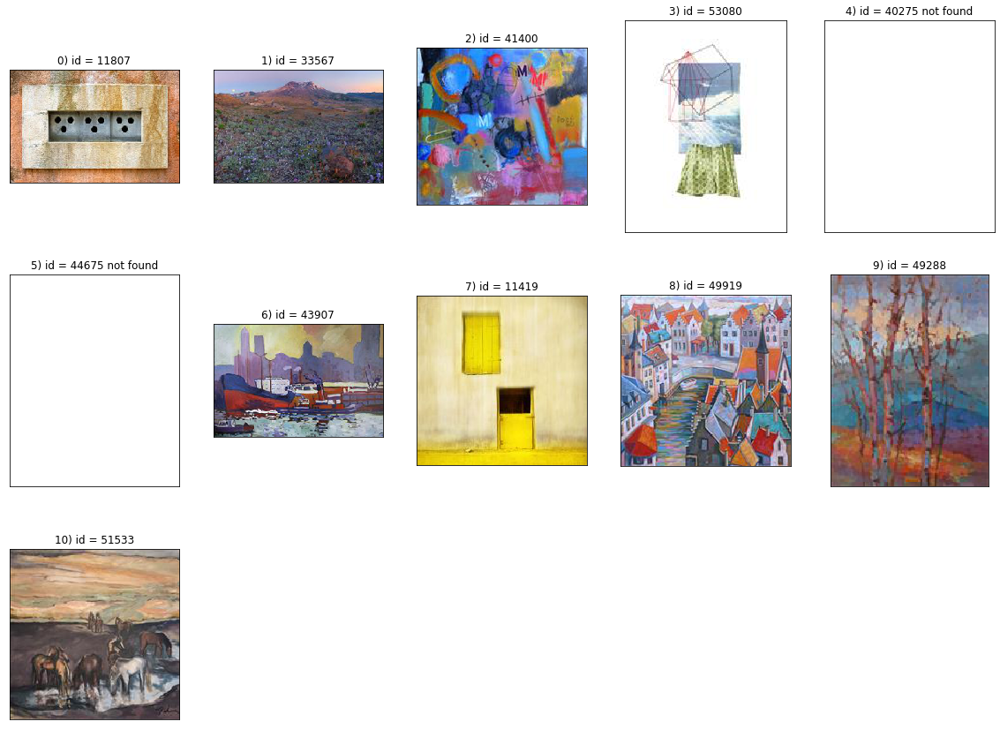




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/12855/Images/Medium_Branca.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/12855/Images/Medium_Branca.jpg


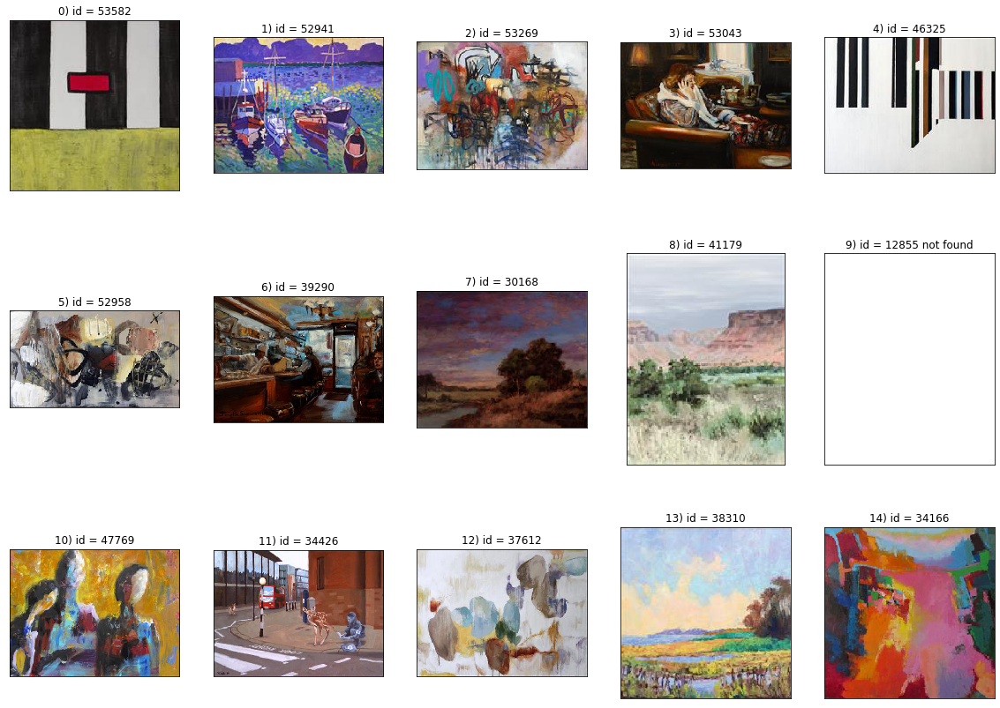

In [30]:
#rec = recommend(resnet50_featmat, user_id=8, topk=15)
#rec = recommend(vgg19_featmat, user_id=8, topk=15)
rec = recommend(pca20_resnet_vgg_hybrid_featmat, user_id=8, topk=15)

## **Pregunta 4** 

Basado en lo visto en clases indica 2 métricas que midan el rendimiento de nuestro modelo recomendador en este problema. ¿Cuáles son las ventajas y desventajas de cada uno?

**Respuesta 4**

Podríamos usar precisión, para saber qué tan buenas están las recomendaciones. Debido a que tenemos un historial de las compras de un usuario, podemos dejar la última compra como el item por predecir (tenerlo en un dataset de testeo) y ver cuantas están bien recomendadas. Lo bueno de esta métrica es que puede ser fácil de implementar, pero lo malo de esto es que puede pasar que un usuario solo compre una pintura, y entonces no se puede podría ver su precisión ya que no se tiene un ground truth para el\ella. \\

Otra métrica que se podría usar es la diversidad. Al usar un CNN, se va a recomendar pinturas con mismas features, y por lo tanto, podría pasar que las recomendaciones no sean muy variadas. Por ejemplo, si a alguien le gusta pinturas abstractas, entonces el modelo solo va a recomendar pinturas de este estilo. Esto podría ser bueno para máximizar la precisión, pero el usuario se podría cansar de ver todo lo mismo. Si vemos que el modelo recomienda todo muy parecido, se podría hacer un fine-tuning para que sea más diverso. El desventaje de usar esta métrica es que se tendría que crear un algoritmo de similaridad entre items, lo cual podría ser difícil según que features fueron aprendidos en el CNN (algunas veces es complejo saber lo que aprendió). 

## **Pregunta 5** 

Genera nuevas recomendaciones mediante la función `recommend` cambiando el tipo de _embedding_ y la métrica de distancia para algún usuario. **Importante** puede ser que algunas imágenes ya no estén disponibles, no se asuste por eso.

**Respuesta 5**

Algo que quería ver era si el tiempo de ejecución entre un modelo y su versión de baja dimensionalidad en verdad mejoraba. Esto se debe a que al disminuir la dimensionalidad, entonces estamos trabajando con menos datos y, por lo tanto, debería demorar menos. \\

All probar resnet_vgg_hybrid_featmat v/s pca20_resnet_vgg_hybrid_featmat para 10 usuarios, el segundo fue 7 segundos más rápido, lo cual es una mejora. Esto válida nuestra hipótesis de que al bajar la dimensionalidad, nuestro algoritmo va a correr más rápido (o al menos se va a demorar menos tiempo). \\

Después, me enfoqué en ver las diferencias de recomendaciones cuando cambiábamos las métricas de distancia. Para este, hice una recomendación de los top 8 items para el usuario 5 utilizando distancia euclidiana y coseno (estas métricas fueron vistas en clase, y por eso se opté usar estas). Al comparar las recomendaciones, no estaban muy diferentes: los primeros 2 items para cada modelo fueron iguales, y en total habían 5 items similares en las recomendaciones. \\

Pero, ahora ocupemos la vista para comparar las recomendaciones que nos dieron al utilizar estas distancias. Para la distancia euclidiana, hay 4 pinturas que son muy monótonas (no tienen mucha variedad de color) y las otras que tienen más color. Por el otro lado, al utilizar distancia coseno, este nos dió 3 pinturas con poca variedad de color y las otras con con más variedad. Por lo tanto, al utilizar distintas métricas de distancia igual nos da recomendaciones de pinturas que son parecidas al solo ocupar nuetros ojos, el cual puede ser mala métrica ya que es subjetivo, pero que igual podría ser útil si es que hacemos encuestas a los usuarios.

In [32]:
import time

user_id =  1
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44087/Images/Medium_stus1601timescuareromanricumbrellas36x241511.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44087/Images/Medium_stus1601timescuareromanricumbrellas36x241511.jpg


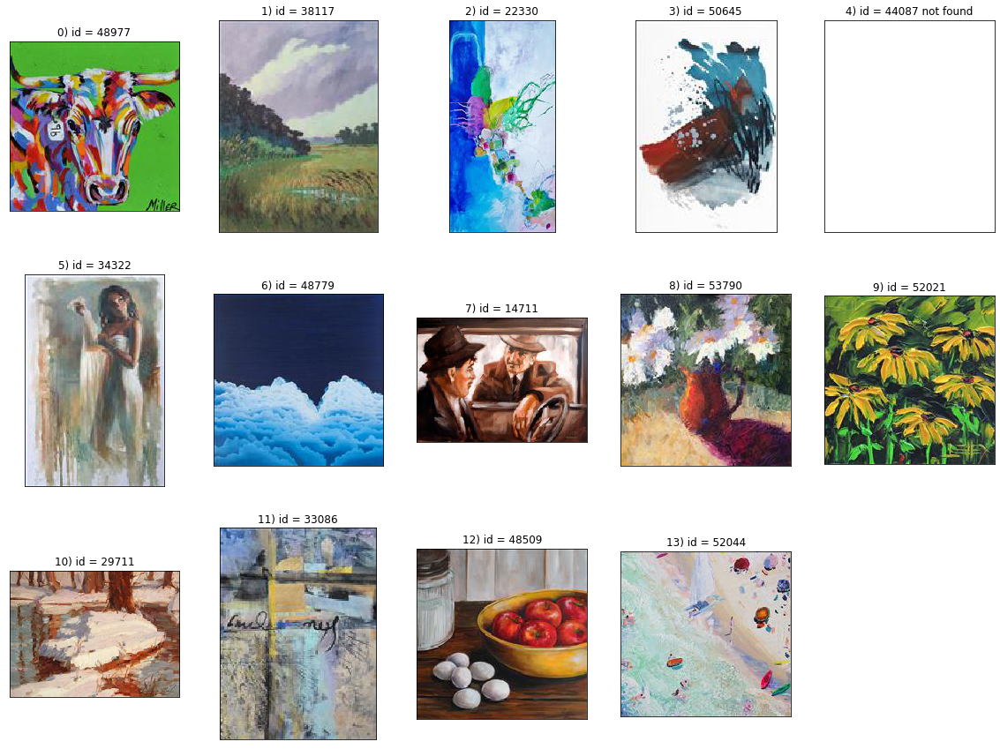




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45169/Images/Medium_stus1604girlwithredumbrella24x2411.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/41378/Images/Medium_DSC005293.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40391/Images/Medium_IMG70141.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45169/Images/Medium_stus1604girlwithredumbrella24x2411.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/41378/Images/Medium_DSC005293.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40391/Images/Medium_IMG70141.jpg


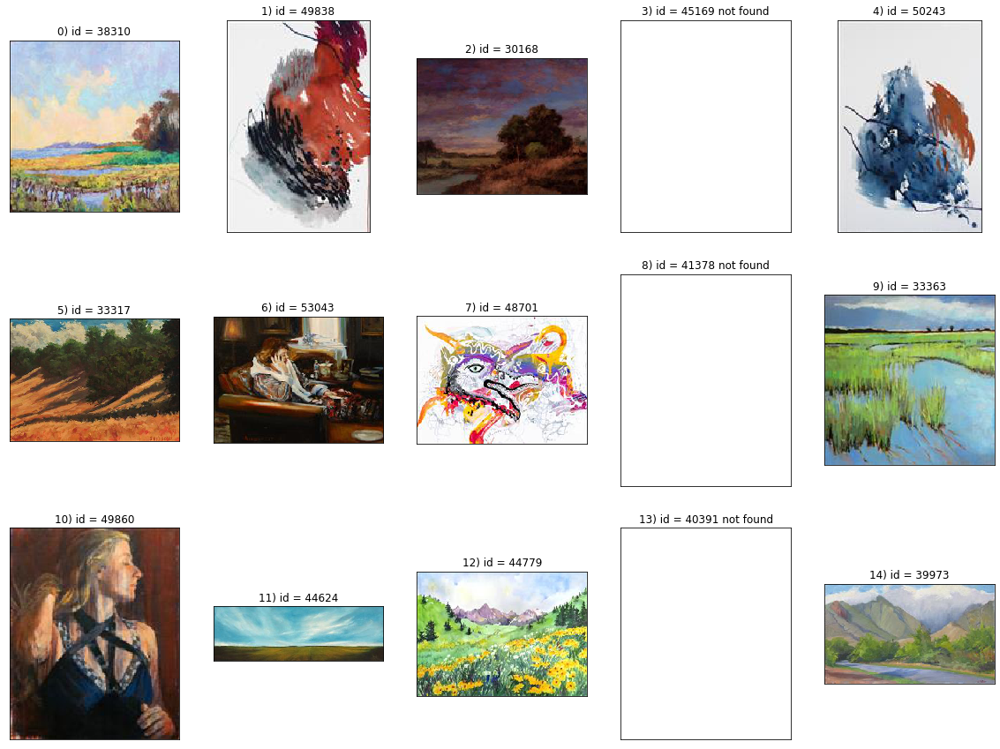

user_id =  2
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/18283/Images/Medium_ReadyToFly12x24.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/35490/Images/Medium_Glowing_Garden.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/18283/Images/Medium_ReadyToFly12x24.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/35490/Images/Medium_Glowing_Garden.jpg


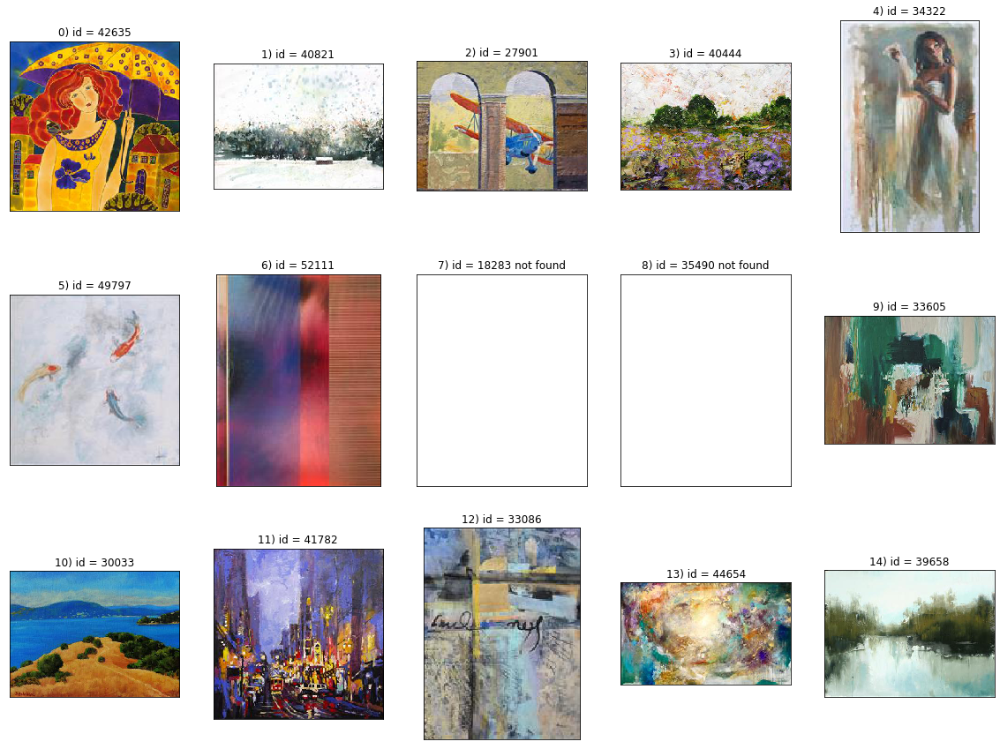




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/36255/Images/Medium_A_Splash_of_Spring.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/36255/Images/Medium_A_Splash_of_Spring.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg


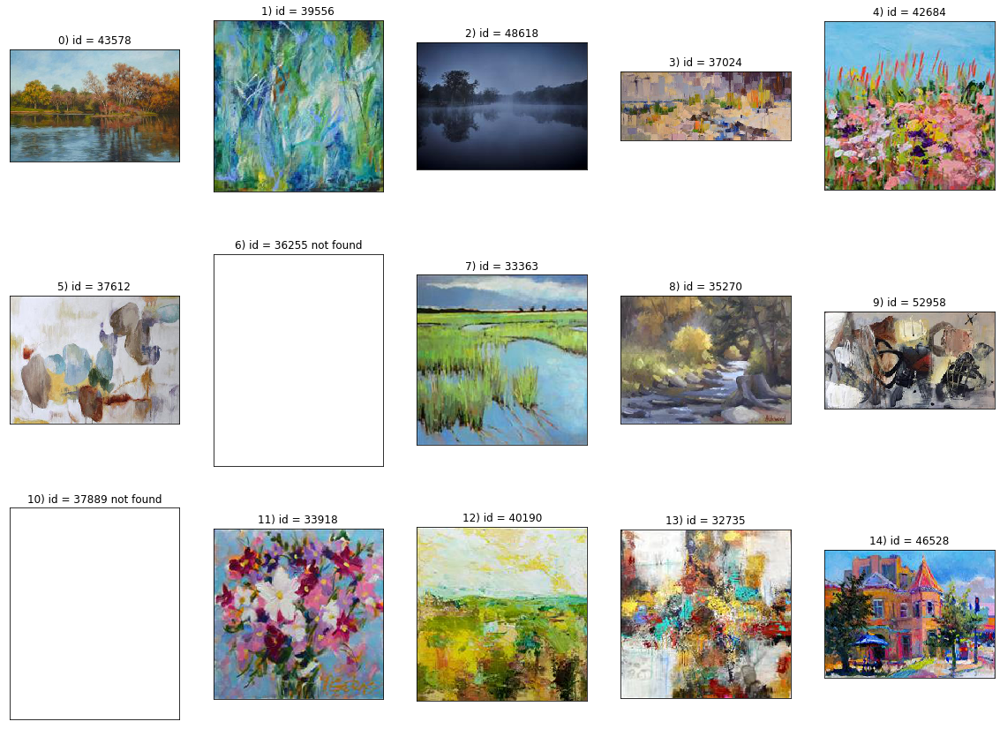

user_id =  3
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/33621/Images/Medium_Awakeing_peaks.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/43092/Images/Medium_OldRanch36x48gal.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/33621/Images/Medium_Awakeing_peaks.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/43092/Images/Medium_OldRanch36x48gal.jpg


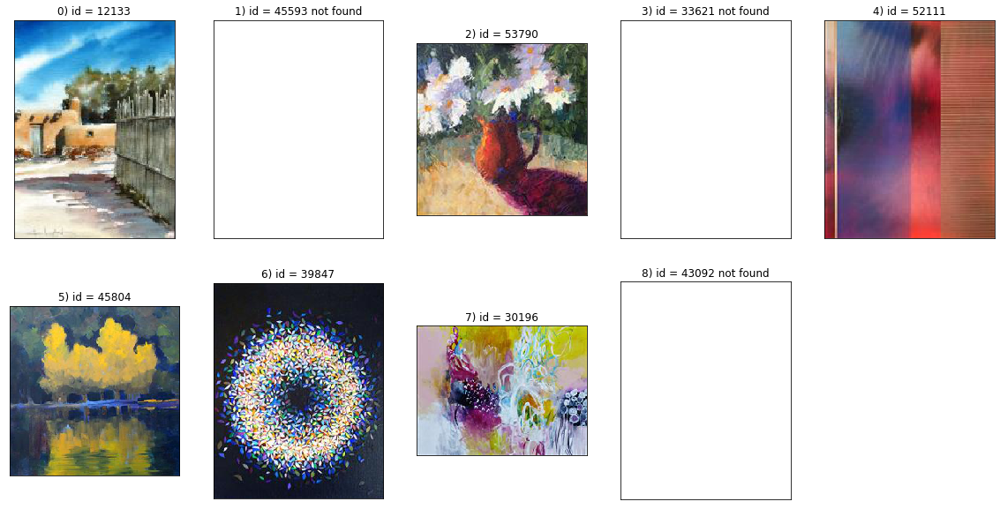




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28396/Images/Medium_FairyTale.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/36255/Images/Medium_A_Splash_of_Spring.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40344/Images/Medium_ArchCape_UGallery.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28396/Images/Medium_FairyTale.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/36255/Images/Medium_A_Splash_of_Spring.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40344/Images/Medium_ArchCape_UGallery.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/produ

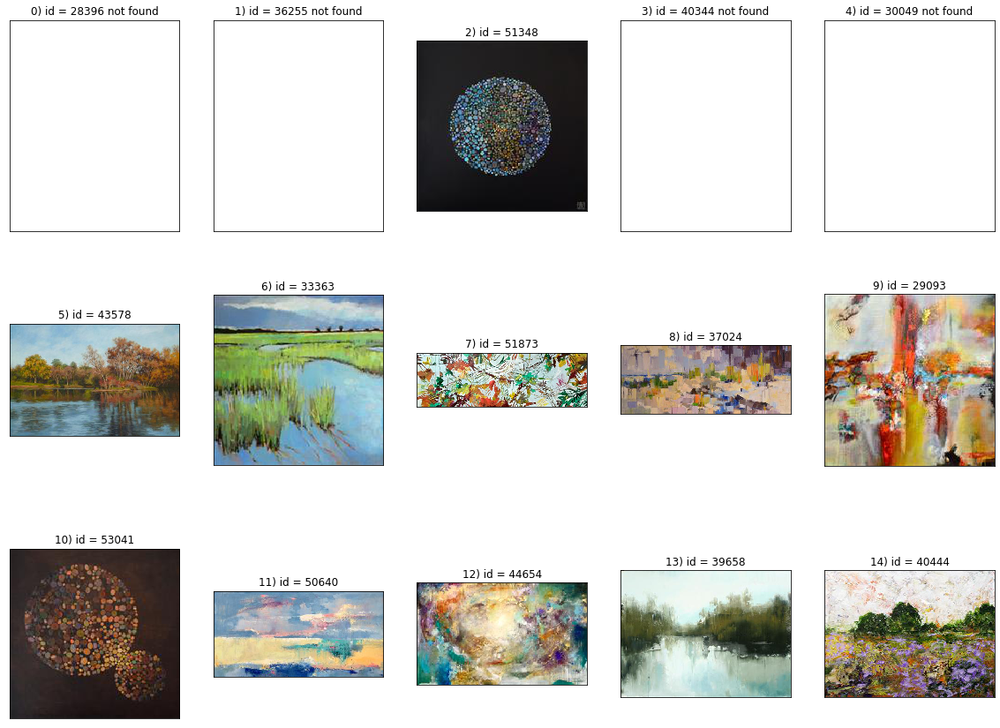

user_id =  4
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/43092/Images/Medium_OldRanch36x48gal.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45169/Images/Medium_stus1604girlwithredumbrella24x2411.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/33339/Images/Medium_Flick-BotsLunch.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/36255/Images/Medium_A_Splash_of_Spring.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/41933/Images/Medium_IMG_1673_2_9x13.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://st

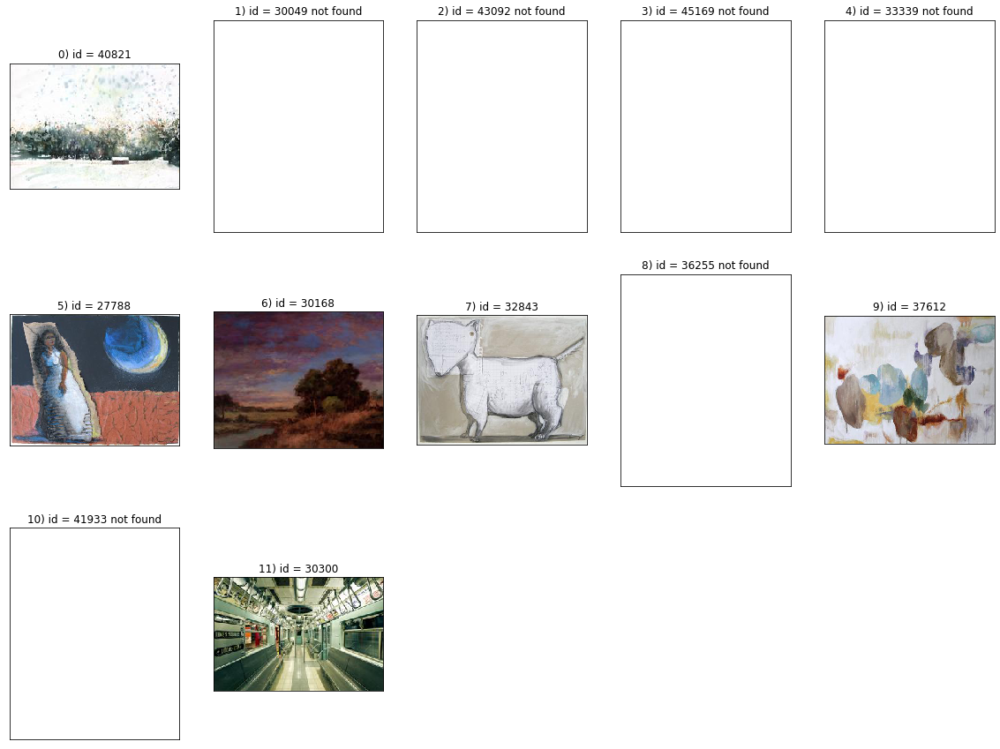




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg


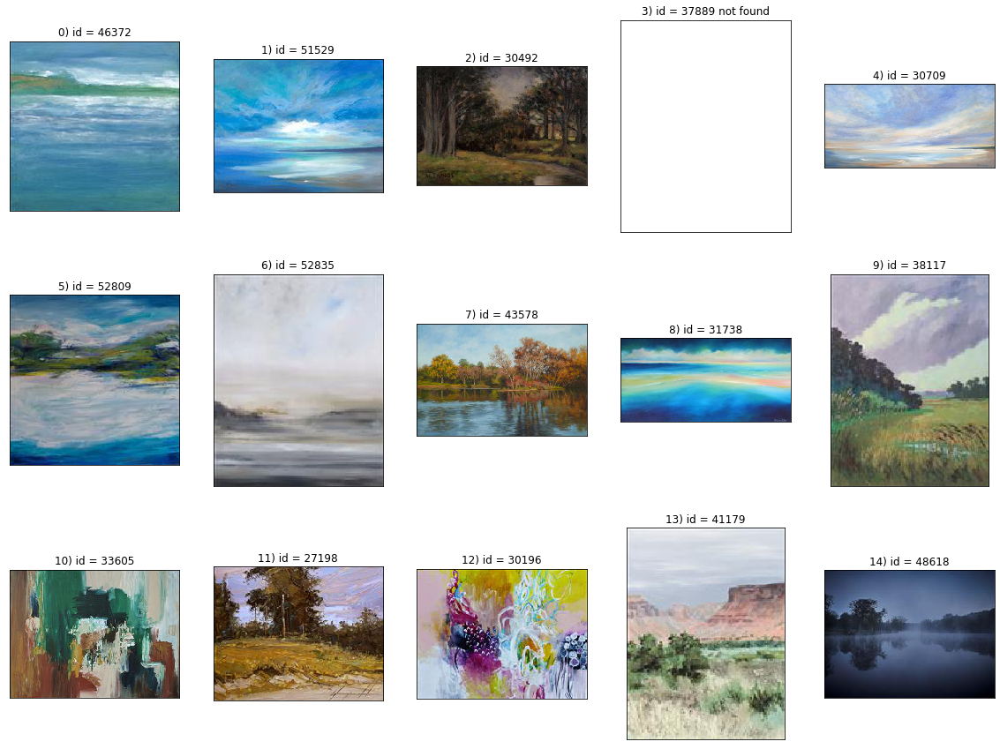

user_id =  5
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28574/Images/Medium_11_1.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/31291/Images/Medium_PeterHoss-piece310.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45499/Images/Medium_valparaisocolorlarge.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28574/Images/Medium_11_1.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/31291/Images/Medium_PeterHoss-piece310.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45499/Images/M

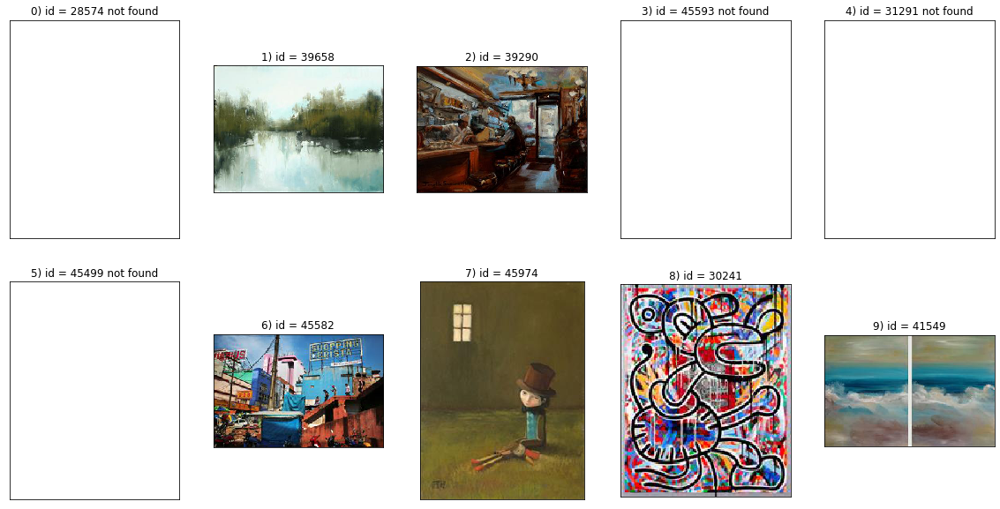




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40344/Images/Medium_ArchCape_UGallery.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/41378/Images/Medium_DSC005293.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40275/Images/Medium_bakery_at_night_padaria_hopper.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/12855/Images/Medium_Branca.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40344/Images/Medium_ArchCape_UGallery.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/

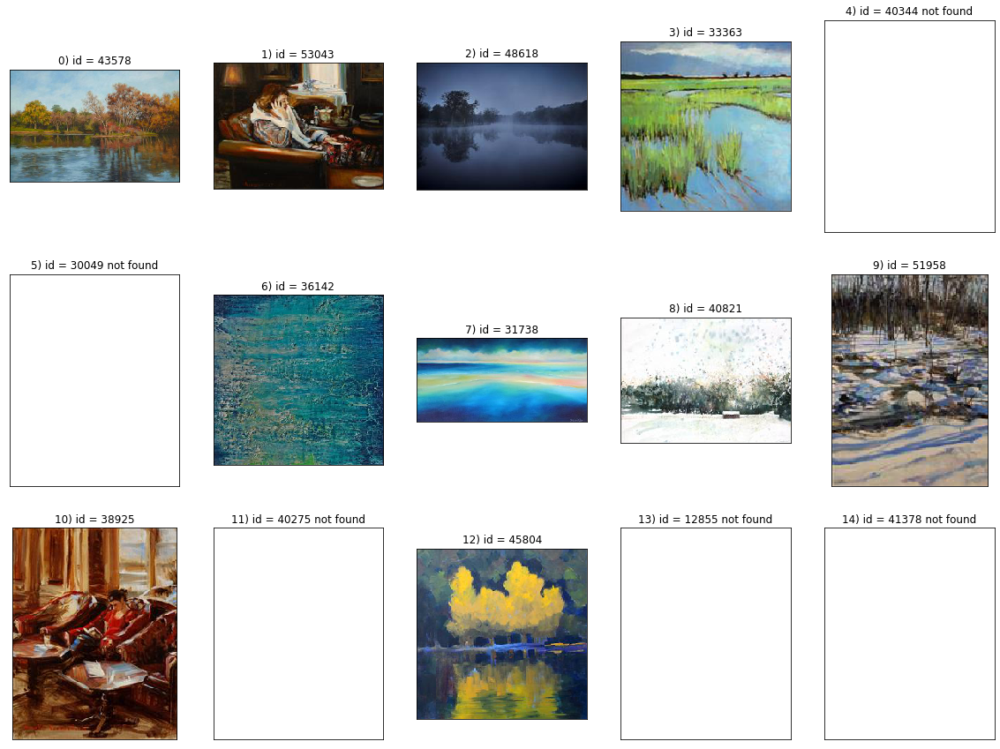

user_id =  6
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40344/Images/Medium_ArchCape_UGallery.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40344/Images/Medium_ArchCape_UGallery.jpg


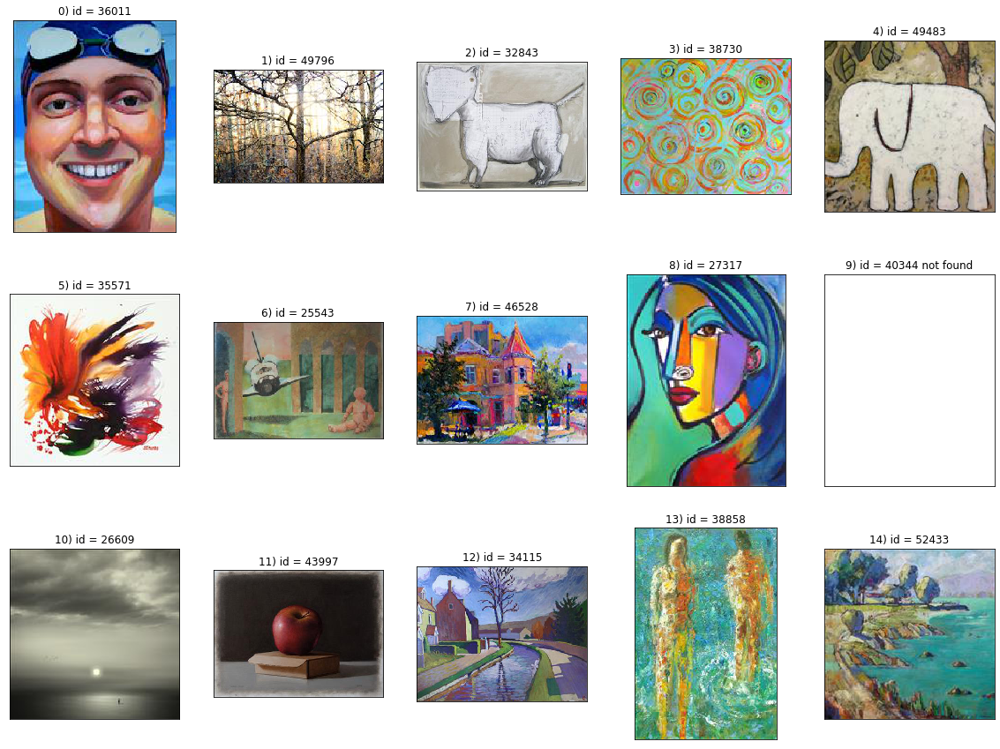




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/22384/Images/Medium_Moonlight_on_Waterjpg.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/22384/Images/Medium_Moonlight_on_Waterjpg.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg


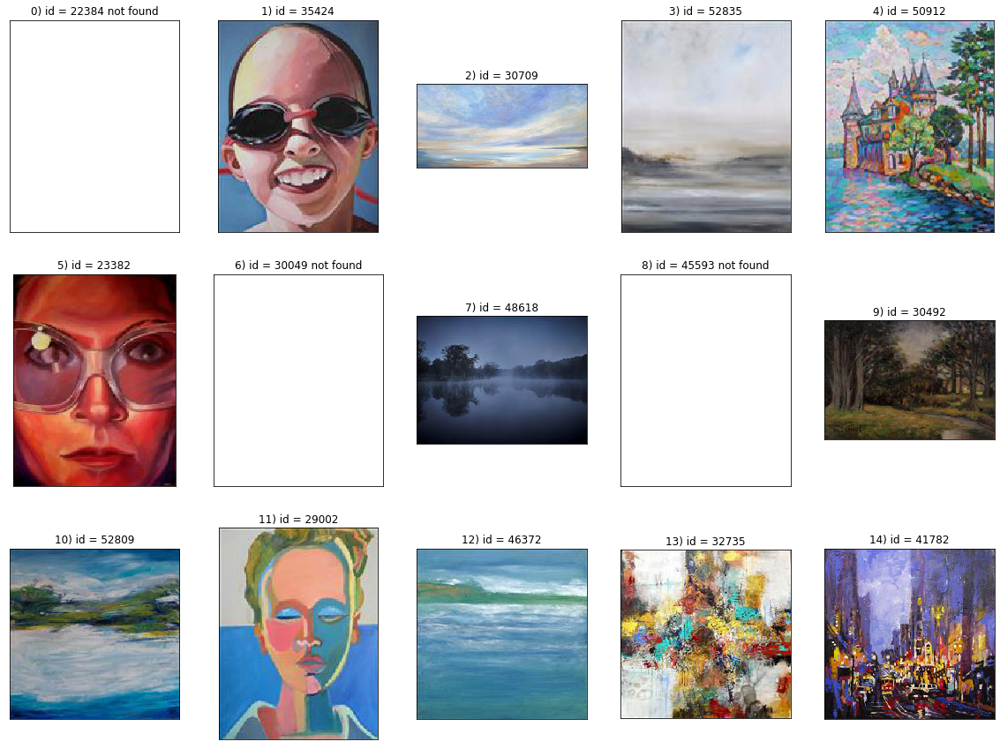

user_id =  7
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/42924/Images/Medium_20x30_Creating_Angel_Wings.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/39531/Images/Medium_Abstract_Landscape_32-image.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45169/Images/Medium_stus1604girlwithredumbrella24x2411.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/29542/Images/Medium_DSC_95151.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/42924/Images/Medium_20x30_Creating_Angel_Wings.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/39531/Images/Medium_Abstract_Landscape_32-image.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45169/Images/Medium_stus1604girlwithredumbrella24x24

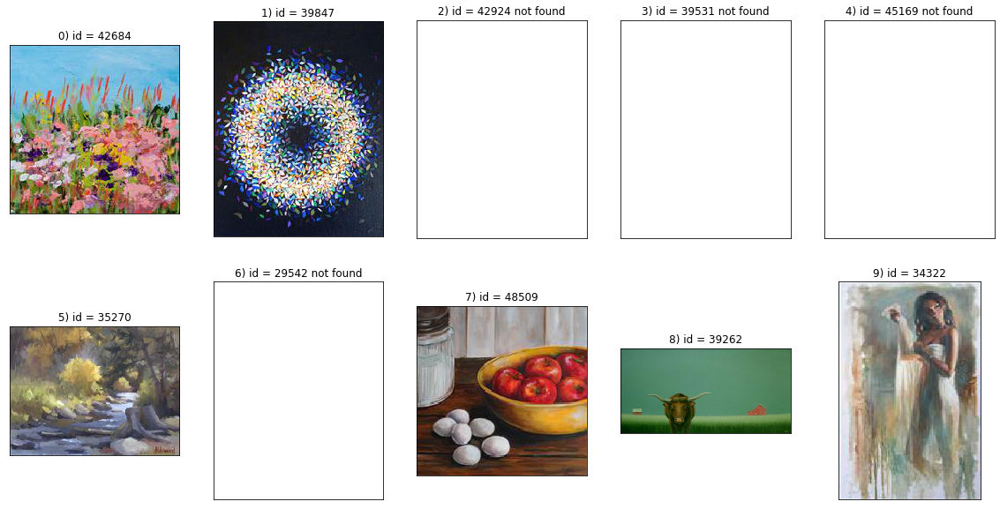




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44087/Images/Medium_stus1601timescuareromanricumbrellas36x241511.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/47139/Images/Medium_showroom.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/35490/Images/Medium_Glowing_Garden.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/39123/Images/Medium_AL_25-image.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44087/Images/Medium_stus1601timescuareromanricumbrellas36x241511.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/47139/Images/Medium_showroom.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/35490/Images/Medium_Glowing_Garden.jpg
unexpected r.status_code = 404 for url =

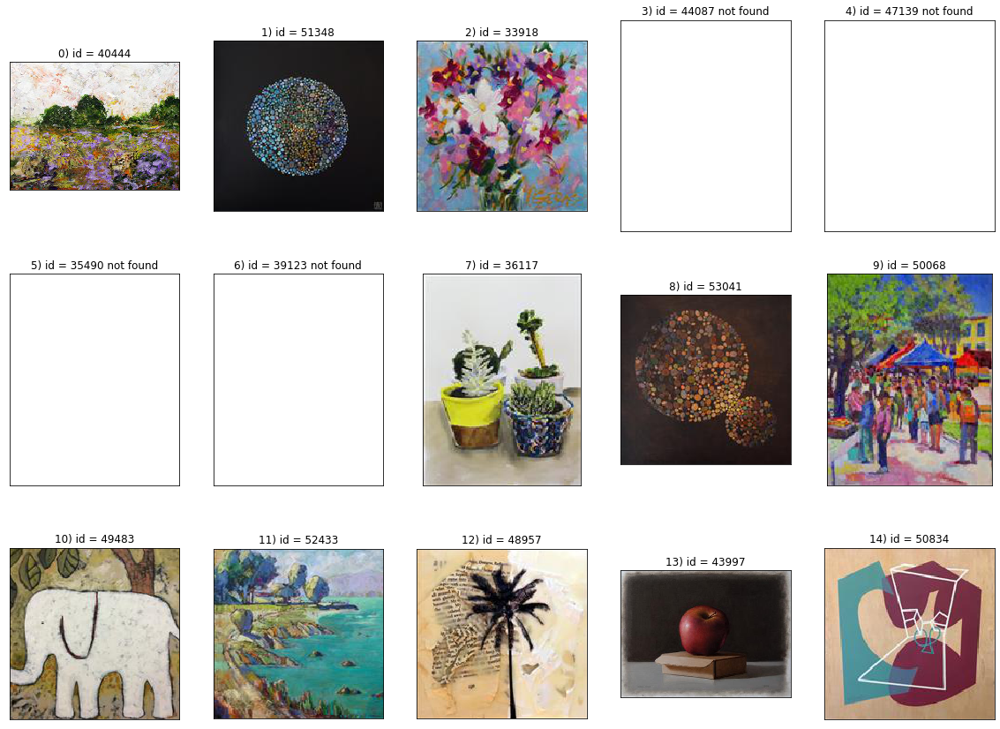

user_id =  8
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40275/Images/Medium_bakery_at_night_padaria_hopper.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44675/Images/Medium_recliningnude.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/40275/Images/Medium_bakery_at_night_padaria_hopper.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/44675/Images/Medium_recliningnude.jpg


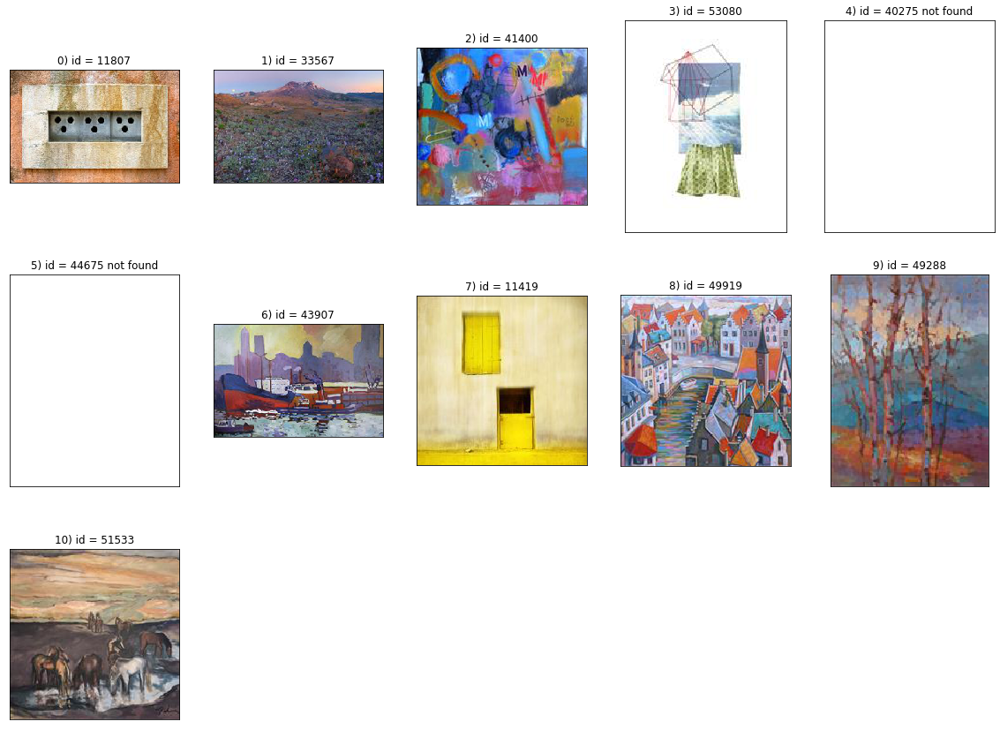




				============ Recommended items =============




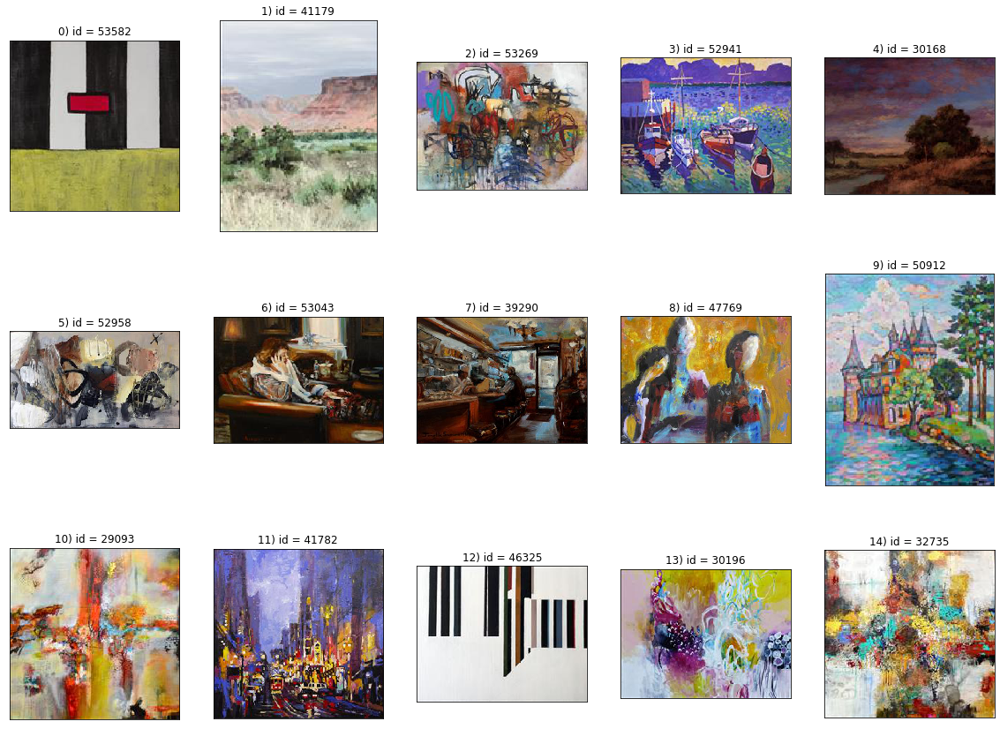

user_id =  9
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/36255/Images/Medium_A_Splash_of_Spring.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/22384/Images/Medium_Moonlight_on_Waterjpg.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/41378/Images/Medium_DSC005293.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/36255/Images/Medium_A_Splash_of_Spring.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/22384/Images/Medium_Moonlight_on_Waterjpg.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/41378/Images/Medium_DSC005293.jpg


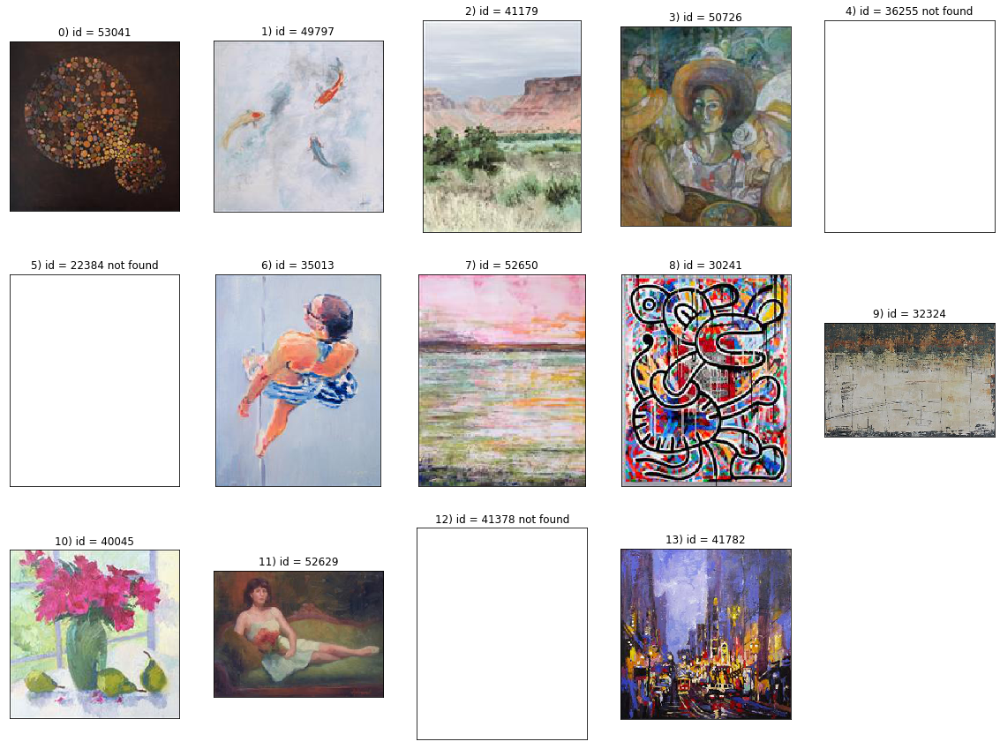




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37889/Images/Medium_Morning_Dew___1500.jpg


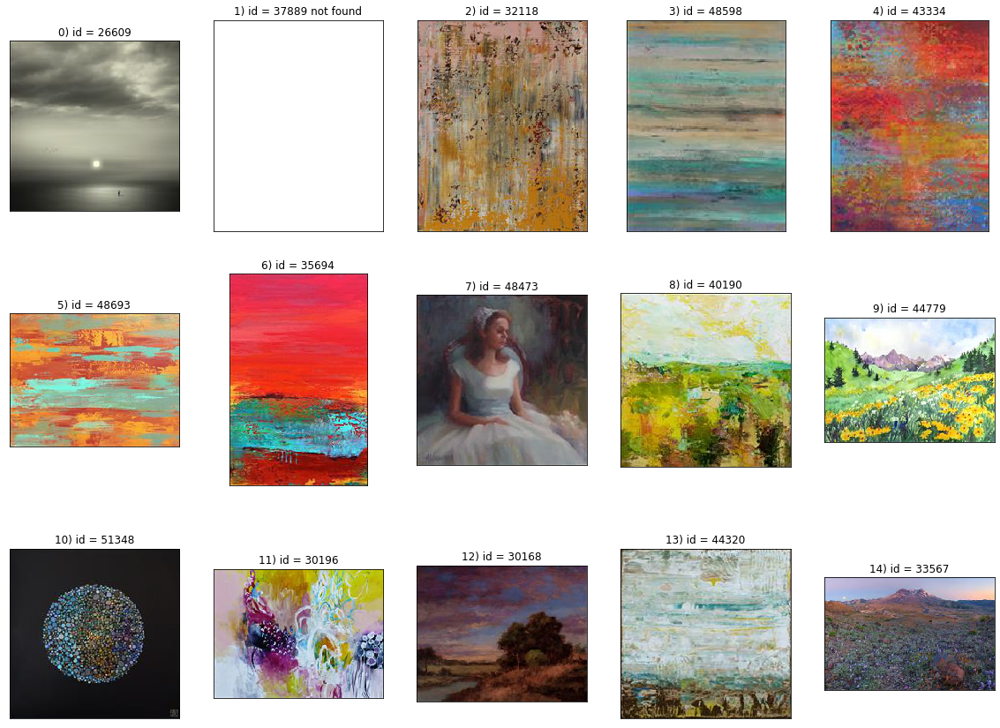

user_id =  10
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/35490/Images/Medium_Glowing_Garden.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/35490/Images/Medium_Glowing_Garden.jpg


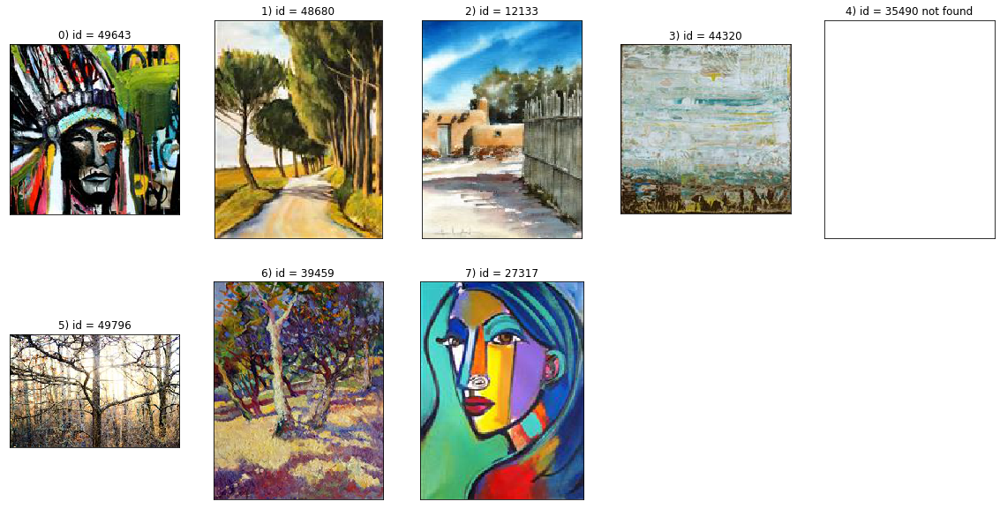




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37901/Images/Medium_DSCN0309ugalleryblackandwhiteportraitmainpicture.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/37901/Images/Medium_DSCN0309ugalleryblackandwhiteportraitmainpicture.jpg


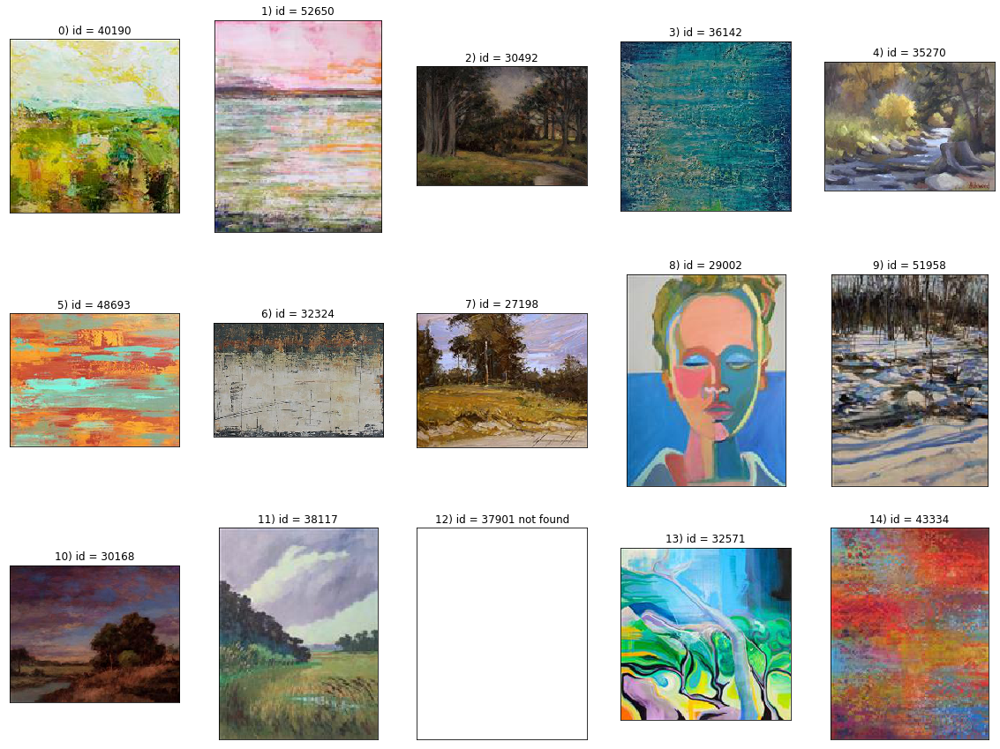

Execution time: 52.282031536102295


In [34]:
start = time.time()

for user in [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]:
  rec = recommend(resnet_vgg_hybrid_featmat, user_id=user, topk=15)

time_taken = time.time() - start
print("Execution time:", time_taken)

Ahora vemos metrica de distancia

user_id =  5
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28574/Images/Medium_11_1.jpgunexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg

unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/31291/Images/Medium_PeterHoss-piece310.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45499/Images/Medium_valparaisocolorlarge.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28574/Images/Medium_11_1.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/31291/Images/Medium_PeterHoss-piece310.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45499/Images/M

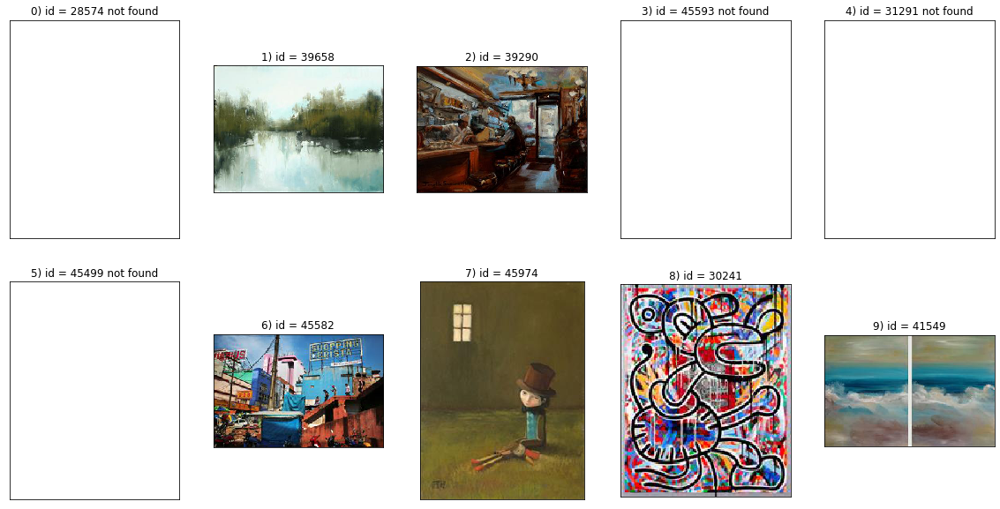




				============ Recommended items =============




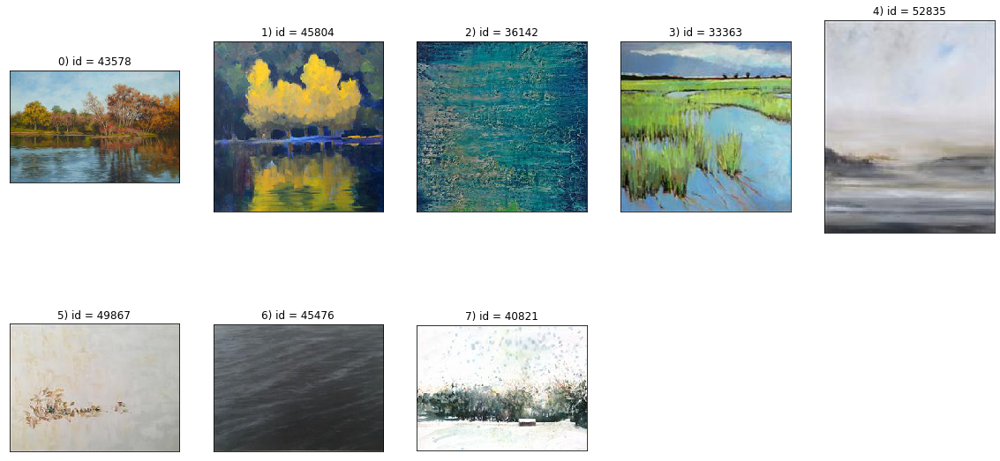

user_id =  5
				============ Consumed items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28574/Images/Medium_11_1.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/31291/Images/Medium_PeterHoss-piece310.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45499/Images/Medium_valparaisocolorlarge.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/28574/Images/Medium_11_1.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45593/Images/Medium_plo4301.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/31291/Images/Medium_PeterHoss-piece310.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/45499/Images/M

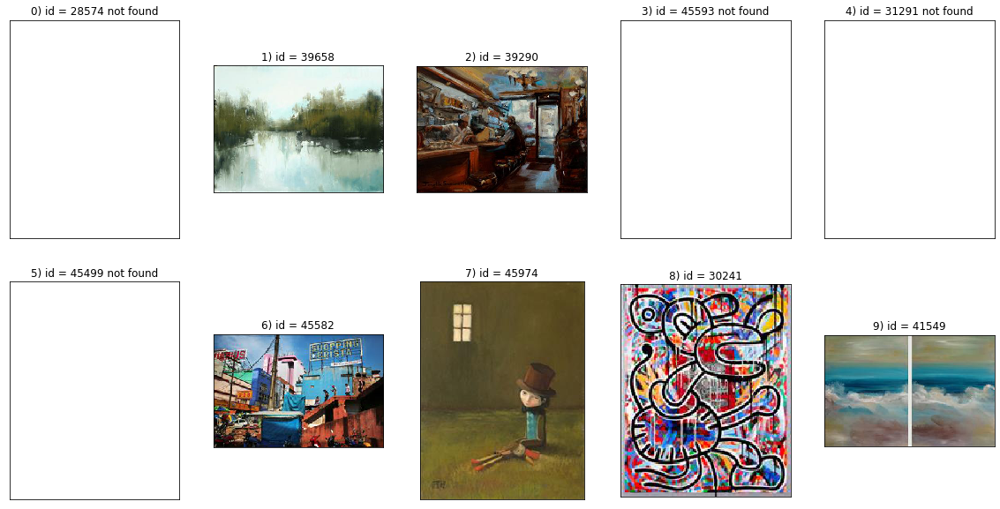




				============ Recommended items =============


unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg
unexpected r.status_code = 404 for url = http://static.ugallery.com/webdata/product/30049/Images/Medium_south_carolina.jpg


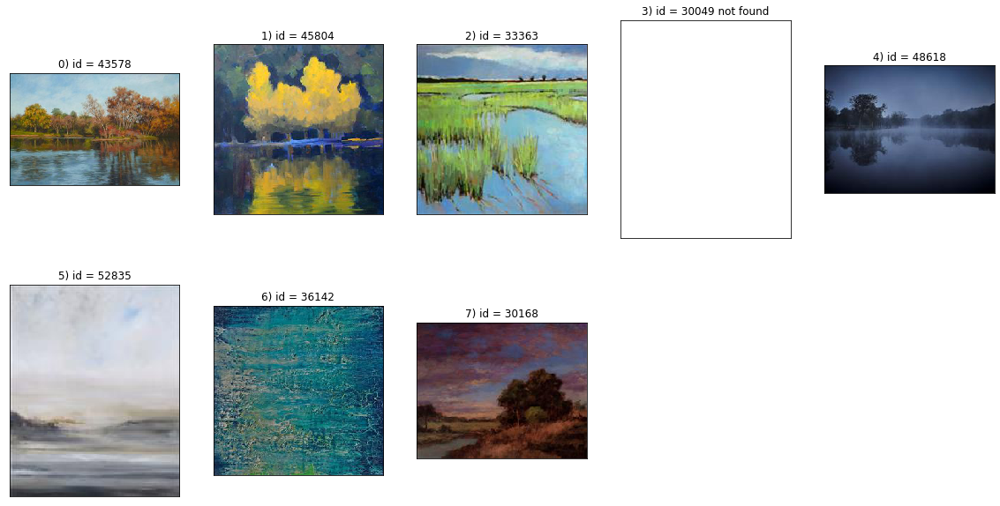

Recommendations with euclidean distance: [43578, 45804, 36142, 33363, 52835, 49867, 45476, 40821]
Recommendations with cosine distance: [43578, 45804, 33363, 30049, 48618, 52835, 36142, 30168]


In [36]:
rec_euc = recommend(vgg19_featmat, user_id=5, topk=8, metric='euclidean')
rec_cos = recommend(vgg19_featmat, user_id=5, topk=8, metric='cosine')

print("Recommendations with euclidean distance:", rec_euc)
print("Recommendations with cosine distance:", rec_cos)